In [1]:
%load_ext autoreload
%autoreload 2

In [7]:
import numpy as np
import os, glob
import json
import matplotlib.pyplot as plt
import libstempo as t2
from enterprise.signals import utils
from enterprise import constants as const
from h5pulsar import Pulsar, FilePulsar
#from enterprise.pulsar import Pulsar
import IPTA_DR2_analysis.utils as dr2u

In [3]:
%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

In [9]:
project_path = '/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis'
#datadir = '/vast/palmer/home.grace/bbl29/DR2/release/VersionB'
savedir = f'{project_path}/data/full_ePSRs'
datadir = f'{project_path}/data/full_partim'
figsave = f'{project_path}/figs/dr2full/resids'

In [5]:
psrlist = []
psrs = glob.glob(datadir + '/J*')
for psr in psrs:
    name = psr.split('/')[-1][:-4]
    psrlist.append(name)
psrlist = np.sort(np.unique(psrlist))
psrlist

array(['J0023+0923', 'J0030+0451', 'J0034-0534', 'J0218+4232',
       'J0340+4130', 'J0437-4715', 'J0610-2100', 'J0613-0200',
       'J0621+1002', 'J0645+5158', 'J0711-6830', 'J0751+1807',
       'J0900-3144', 'J0931-1902', 'J1012+5307', 'J1022+1001',
       'J1024-0719', 'J1045-4509', 'J1455-3330', 'J1600-3053',
       'J1603-7202', 'J1614-2230', 'J1640+2224', 'J1643-1224',
       'J1713+0747', 'J1721-2457', 'J1730-2304', 'J1732-5049',
       'J1738+0333', 'J1741+1351', 'J1744-1134', 'J1747-4036',
       'J1751-2857', 'J1801-1417', 'J1802-2124', 'J1804-2717',
       'J1824-2452A', 'J1832-0836', 'J1843-1113', 'J1853+1303',
       'J1857+0943', 'J1903+0327', 'J1909-3744', 'J1910+1256',
       'J1911+1347', 'J1911-1114', 'J1918-0642', 'J1923+2515',
       'J1939+2134', 'J1944+0907', 'J1949+3106', 'J1955+2908',
       'J2010-1323', 'J2017+0603', 'J2019+2425', 'J2033+1734',
       'J2043+1711', 'J2124-3358', 'J2129-5721', 'J2145-0750',
       'J2214+3000', 'J2229+2643', 'J2302+4442', 'J231

In [13]:
def plot_resids_byfrequency(psr):
    fig, ax = plt.subplots(figsize=(8,4))
    ax.errorbar(psr.toas/const.day, psr.residuals*1e6, yerr=psr.toaerrs*1e6,
                fmt='.k', marker=None, mew=0, alpha=0.5, lw=1, zorder=0)
    sc = ax.scatter(psr.toas/const.day, psr.residuals*1e6, s=5, c=psr.freqs, cmap='Spectral')
    cbar = plt.colorbar(sc)
    cbar.set_label(r"$\nu$ (MHz)")
    ax.set_xlabel("MJD")
    ax.set_ylabel(r"Residual ($\mu s$)")
    ax.grid(linewidth=0.3)
    ax.set_title(psr.name)
    fig.tight_layout()

In [6]:
def plot_resids_bypta(psr):
    fig, ax = plt.subplots(figsize=(8,4))
    ax.errorbar(psr.toas/const.day, psr.residuals*1e6, yerr=psr.toaerrs*1e6,
                fmt='.k', marker=None, mew=0, alpha=0.5, lw=1, zorder=0)
    for i, pta in enumerate(['NANOGrav','EPTA','PPTA']):
        if pta in psr.flags['pta']:
            mask = psr.flags['pta'] == pta
            sc = ax.scatter(psr.toas[mask]/const.day, psr.residuals[mask]*1e6, s=5,
                            c=f'C{i}', label=pta)
    cbar = plt.colorbar(sc)
    cbar.set_label(r"$\nu$ (MHz)")
    ax.set_xlabel("MJD")
    ax.set_ylabel(r"Residual ($\mu s$)")
    ax.grid(linewidth=0.3)
    ax.set_title(psr.name)
    ax.legend()
    fig.tight_layout()

In [17]:
def plot_resids(psr, save=None):
    fig, ax = plt.subplots(figsize=(8,4))
    nu_min = np.min(psr.freqs)
    nu_max = np.max(psr.freqs)
    for marker, pta in zip(['s','o','*'], ['NANOGrav','EPTA','PPTA']):
        if pta in psr.flags['pta']:
            mask = psr.flags['pta'] == pta
            ax.errorbar(psr.toas[mask]/const.day, psr.residuals[mask]*1e6, yerr=psr.toaerrs[mask]*1e6,
                        fmt=f'{marker}k', ms=5, marker=None, mew=0, alpha=0.5, lw=1, zorder=0, label=pta)
            sc = ax.scatter(psr.toas[mask]/const.day, psr.residuals[mask]*1e6, s=5, marker=marker,
                            c=psr.freqs[mask], cmap='Spectral', vmin=nu_min, vmax=nu_max)
    cbar = plt.colorbar(sc)
    cbar.set_label(r"$\nu$ (MHz)")
    ax.set_xlabel("MJD")
    ax.set_ylabel(r"Residual ($\mu s$)")
    ax.grid(linewidth=0.3)
    ax.set_title(psr.name)
    ax.legend()
    fig.tight_layout()
    if save:
        fig.savefig(f'{figsave}/{psr.name}.png', dpi=300, bbox_inches='tight')

J0023+0923


Cutting J0023+0923 since Tspan is too short (2.301883192684368 < 3 yr)
J0030+0451
[preProcess.C:158] Warning: PSR J0030+0451 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J0023+0923 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J0030+0451 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor



J0034-0534
[preProcess.C:158] Warning: PSR J0034-0534 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0218+4232


[preProcess.C:158] Warning: PSR J0218+4232 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0340+4130


Cutting J0340+4130 since Tspan is too short (1.6818098681272595 < 3 yr)
J0437-4715
[preProcess.C:158] Warning: PSR J0340+4130 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J0437-4715 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0610-2100


[preProcess.C:158] Warning: PSR J0610-2100 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0613-0200
[preProcess.C:158] Warning: PSR J0613-0200 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0621+1002


[preProcess.C:158] Warning: PSR J0621+1002 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0645+5158


Cutting J0645+5158 since Tspan is too short (2.4158083047909917 < 3 yr)
J0711-6830
[preProcess.C:158] Warning: PSR J0645+5158 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J0711-6830 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0751+1807


[preProcess.C:158] Warning: PSR J0751+1807 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0900-3144


[preProcess.C:158] Warning: PSR J0900-3144 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J0931-1902


Cutting J0931-1902 since Tspan is too short (0.6444985077953321 < 3 yr)
J1012+5307
[preProcess.C:158] Warning: PSR J0931-1902 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J1012+5307 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1022+1001
[preProcess.C:158] Warning: PSR J1022+1001 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1024-0719
[preProcess.C:158] Warning: PSR J1024-0719 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2

[preProcess.C:158] Warning: PSR J1614-2230 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1640+2224
[preProcess.C:158] Warning: PSR J1640+2224 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1643-1224
[preProcess.C:158] Warning: PSR J1643-1224 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1713+0747
[preProcess.C:158] Warning: PSR J1713+0747 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor



/tmp/ipykernel_2762991/2475856012.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(8,4))


J1721-2457
[preProcess.C:158] Warning: PSR J1721-2457 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1730-2304
[preProcess.C:158] Warning: PSR J1730-2304 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1732-5049
[preProcess.C:158] Warning: PSR J1732-5049 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1738+0333


[preProcess.C:158] Warning: PSR J1738+0333 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1741+1351


[preProcess.C:158] Warning: PSR J1741+1351 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1744-1134
[preProcess.C:158] Warning: PSR J1744-1134 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1747-4036


Cutting J1747-4036 since Tspan is too short (1.6682514930867205 < 3 yr)
J1751-2857
[preProcess.C:158] Warning: PSR J1747-4036 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J1751-2857 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1801-1417


[preProcess.C:158] Warning: PSR J1801-1417 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1802-2124


[preProcess.C:158] Warning: PSR J1802-2124 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1804-2717


[preProcess.C:158] Warning: PSR J1804-2717 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1824-2452A
[preProcess.C:158] Warning: PSR J1824-2452A uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1832-0836


Cutting J1832-0836 since Tspan is too short (0.6335558016671244 < 3 yr)
J1843-1113
[preProcess.C:158] Warning: PSR J1832-0836 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J1843-1113 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1853+1303


[preProcess.C:158] Warning: PSR J1853+1303 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1857+0943
[preProcess.C:158] Warning: PSR J1857+0943 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1903+0327


[preProcess.C:158] Warning: PSR J1903+0327 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1909-3744
[preProcess.C:158] Warning: PSR J1909-3744 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1910+1256
[preProcess.C:158] Warning: PSR J1910+1256 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1911+1347


[preProcess.C:158] Warning: PSR J1911+1347 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1911-1114
[preProcess.C:158] Warning: PSR J1911-1114 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1918-0642
[preProcess.C:158] Warning: PSR J1918-0642 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1923+2515


Cutting J1923+2515 since Tspan is too short (2.1978567250328807 < 3 yr)
J1939+2134
[preProcess.C:158] Warning: PSR J1923+2515 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J1939+2134 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[observatory.C:272] Warning: Assuming site 'w' means 'ncyobs'
J1944+0907


[preProcess.C:158] Warning: PSR J1944+0907 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J1949+3106


Cutting J1949+3106 since Tspan is too short (1.2450738930878695 < 3 yr)
J1955+2908
[preProcess.C:158] Warning: PSR J1949+3106 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor



[preProcess.C:158] Warning: PSR J1955+2908 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2010-1323


[preProcess.C:158] Warning: PSR J2010-1323 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2017+0603


Cutting J2017+0603 since Tspan is too short (1.6682360649021852 < 3 yr)
J2019+2425
[preProcess.C:158] Warning: PSR J2017+0603 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J2019+2425 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2033+1734


[preProcess.C:158] Warning: PSR J2033+1734 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2043+1711


Cutting J2043+1711 since Tspan is too short (2.282694489701086 < 3 yr)
J2124-3358
[preProcess.C:158] Warning: PSR J2043+1711 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J2124-3358 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2129-5721
[preProcess.C:158] Warning: PSR J2129-5721 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2145-0750
[preProcess.C:158] Warning: PSR J2145-0750 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/

Cutting J2214+3000 since Tspan is too short (2.0668574651006506 < 3 yr)
J2229+2643
[preProcess.C:158] Warning: PSR J2214+3000 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J2229+2643 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2302+4442


Cutting J2302+4442 since Tspan is too short (1.6817920589211606 < 3 yr)
J2317+1439
[preProcess.C:158] Warning: PSR J2302+4442 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

[preProcess.C:158] Warning: PSR J2317+1439 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor

J2322+2057


[preProcess.C:158] Warning: PSR J2322+2057 uses DM2+ but does not define DM_SERIES. Assume Taylor. This has behaviour has changed since June 2020!
See https://bitbucket.org/psrsoft/tempo2/issues/27/tempo2-dm-polynomial-is-not-a-taylor



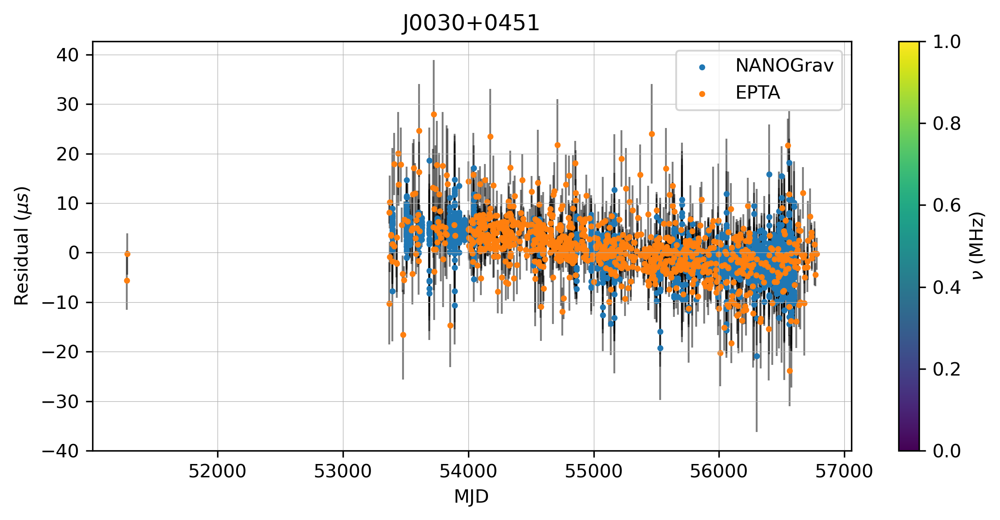

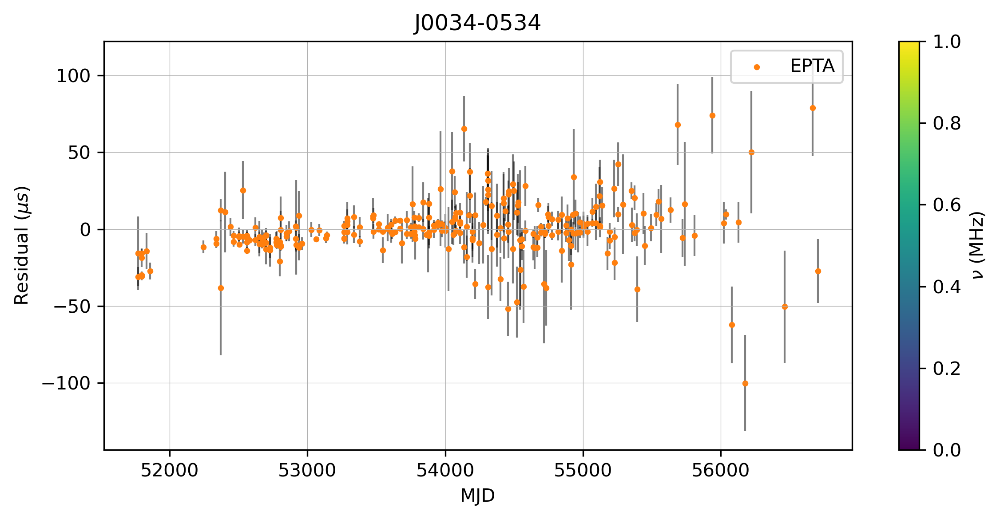

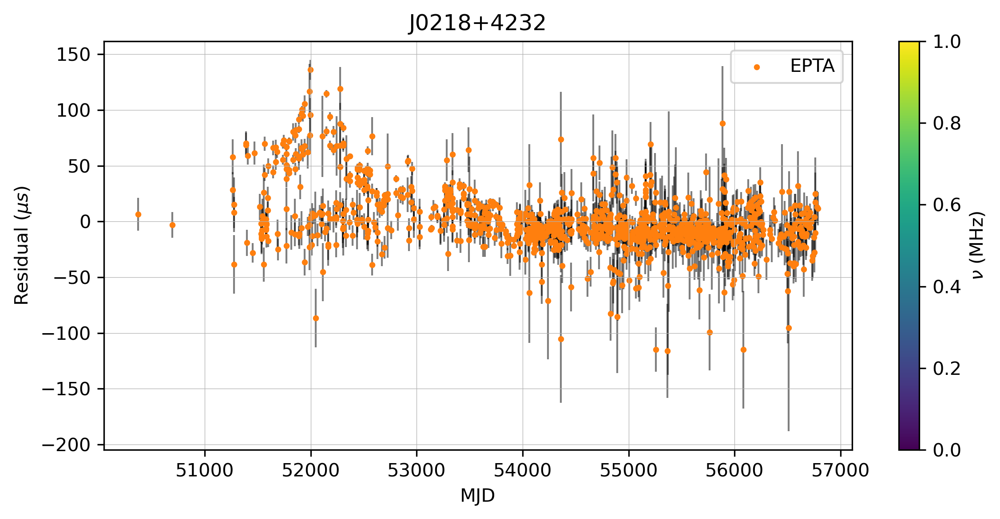

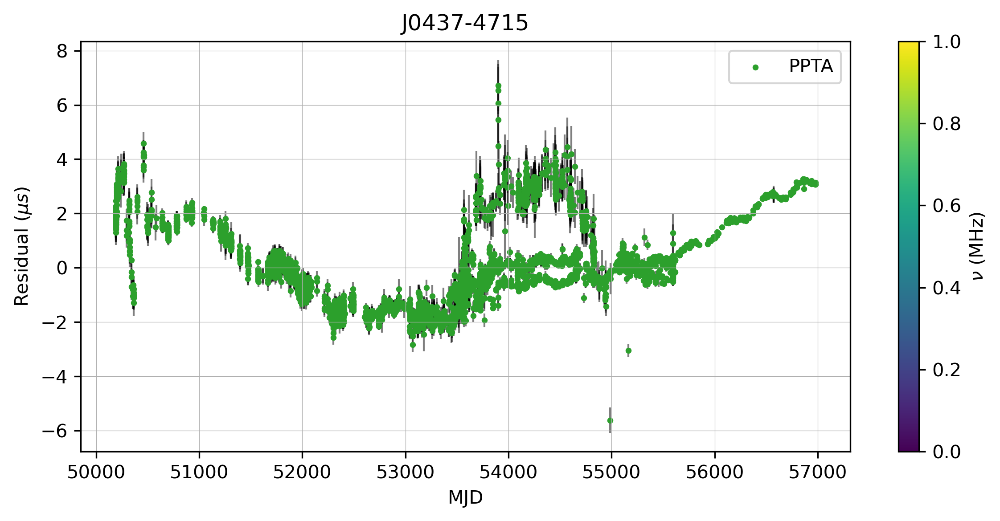

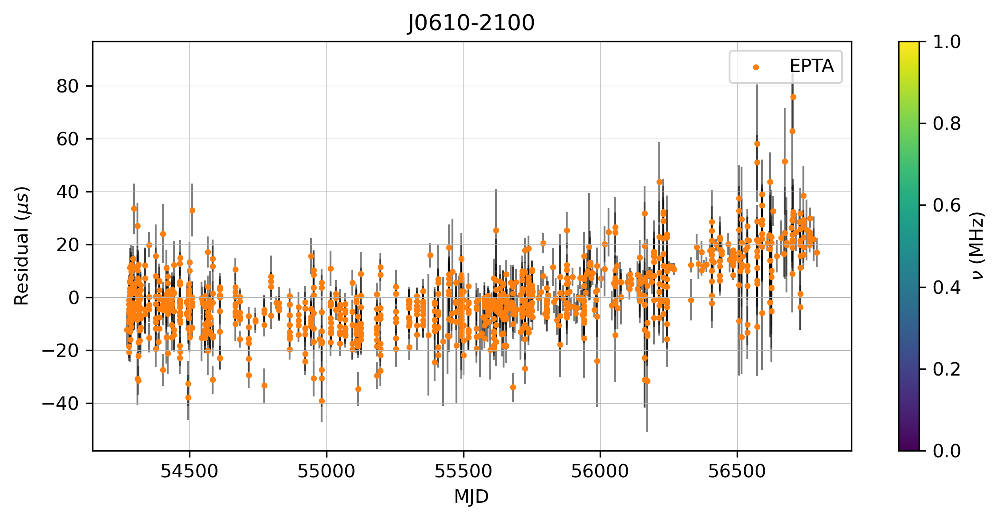

...

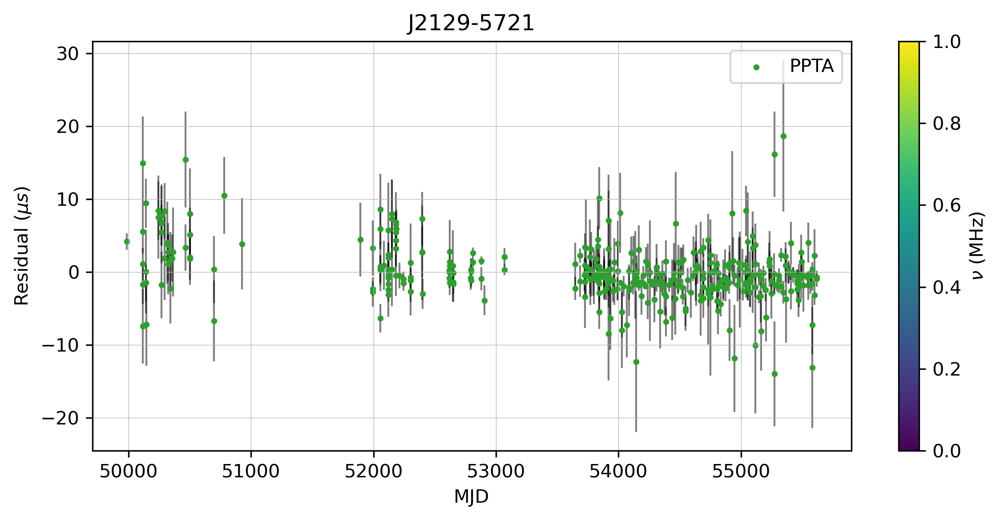

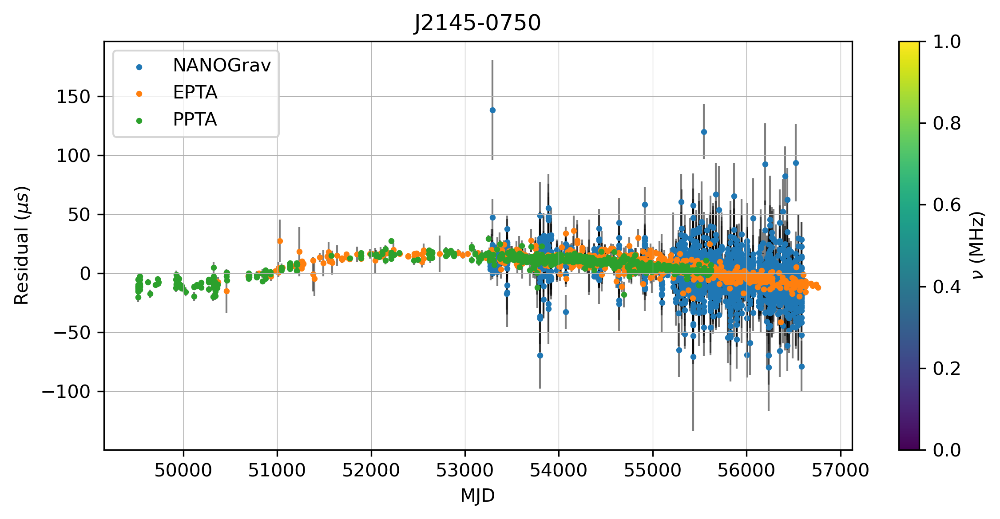

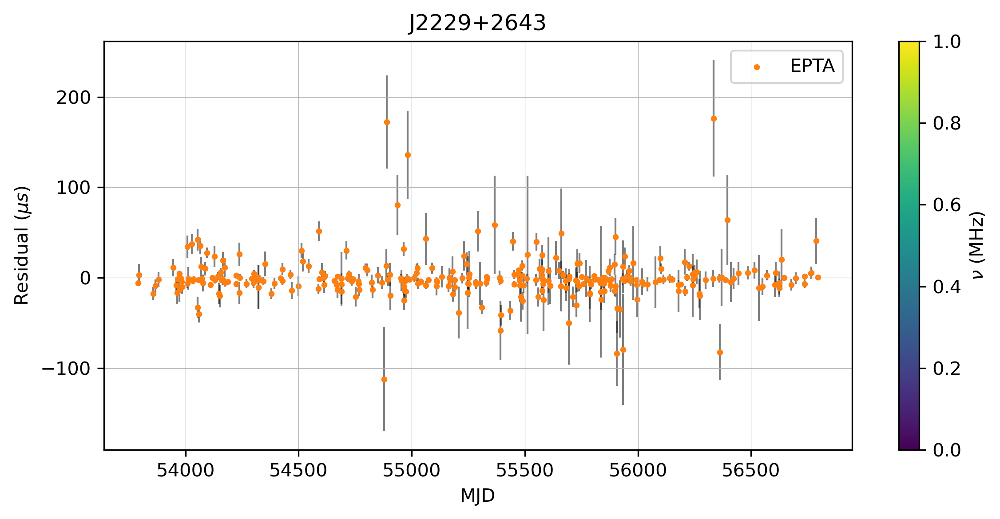

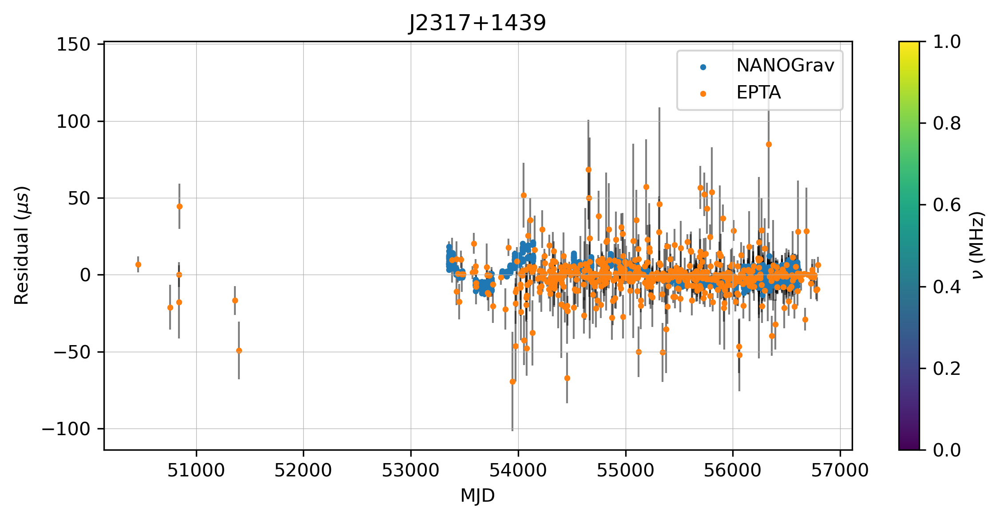

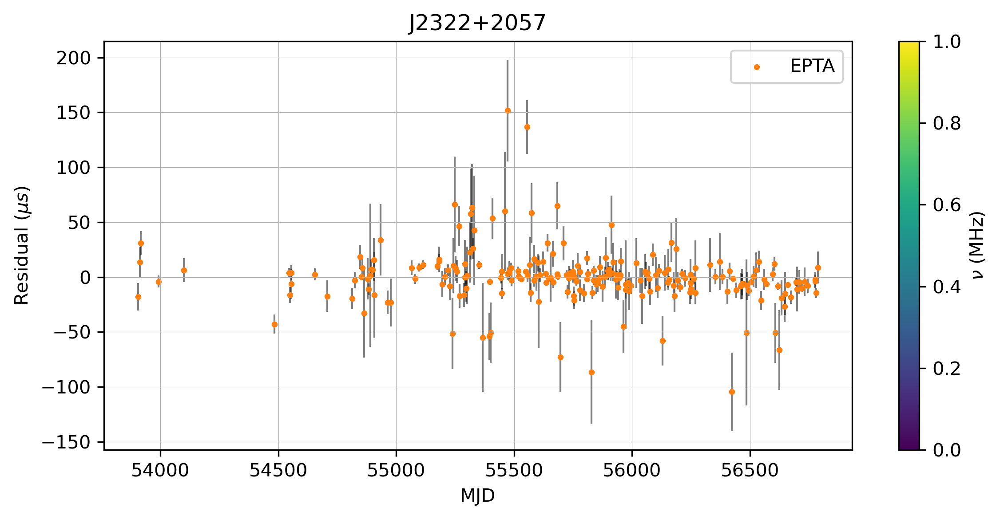

In [9]:
psrs = []
for psrname in psrlist:
    # load pulsar
    print(psrname)
    parfile = f'{datadir}/{psrname}.par'
    timfile = f'{datadir}/{psrname}.tim'
    psr = Pulsar(parfile, timfile, ephem='DE438')
    # apply 3-year cut
    Tspan = (np.max(psr.toas) - np.min(psr.toas))/const.yr
    if Tspan < 3:
        print(f'Cutting {psrname} since Tspan is too short ({Tspan} < 3 yr)')
        continue
    # add to list of pulsars, save and make resids plot
    psr.to_hdf5(f'{savedir}/{psrname}.hdf5')
    plot_resids_bypta(psr)
    psrs.append(psr)

In [10]:
print(len(psrs))

53


In [29]:
# get Tspan
min_toa = np.min([np.min(psr.toas) for psr in psrs])
max_toa = np.max([np.max(psr.toas) for psr in psrs])
Tspan = max_toa - min_toa
print(f'Tspan in seconds = {Tspan}')
print(f'Tspan in years = {Tspan/const.yr}')

Tspan in seconds = 952746385.6296968
Tspan in years = 30.190711132332524


/tmp/ipykernel_3246839/4157390576.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(8,4))


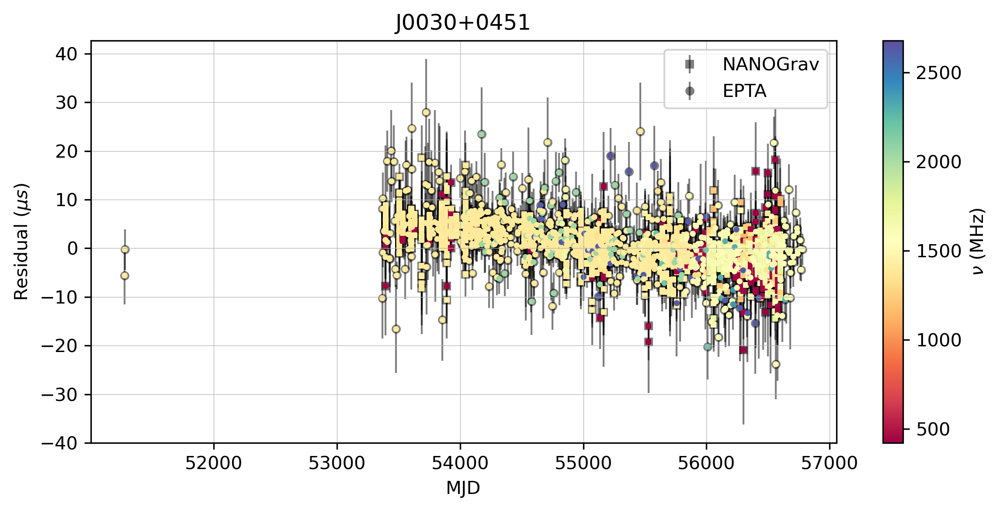

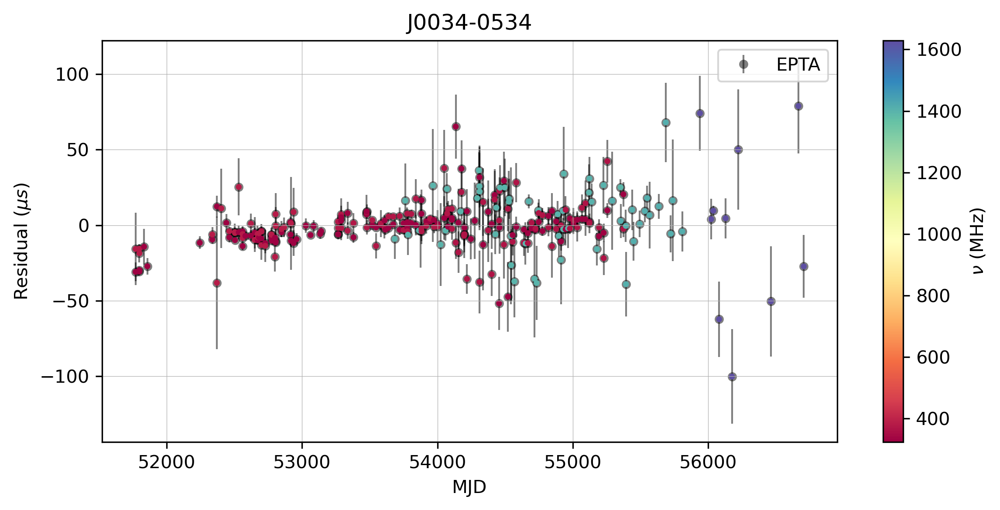

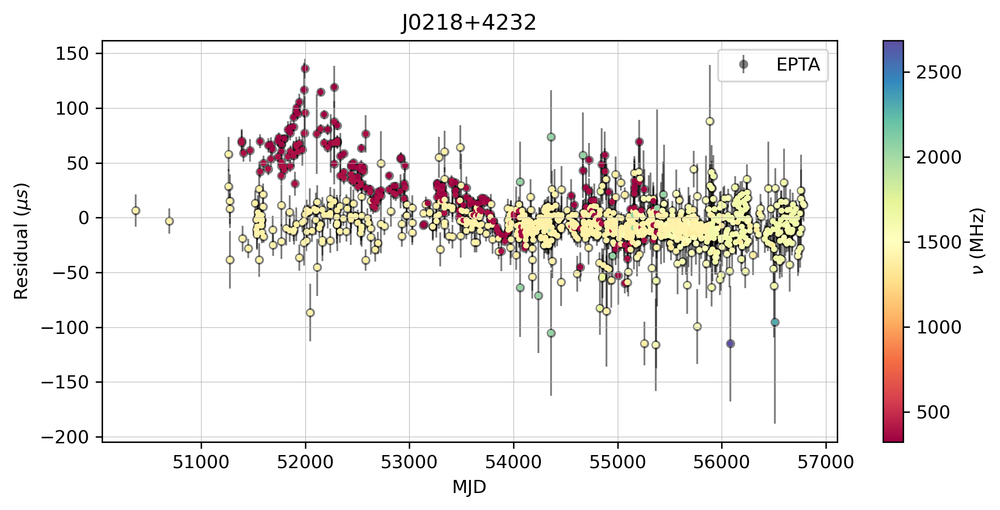

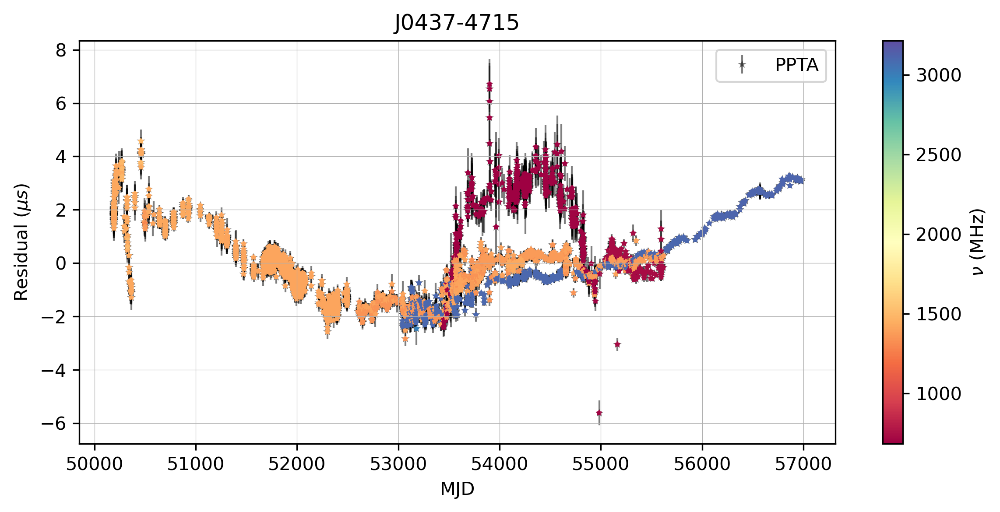

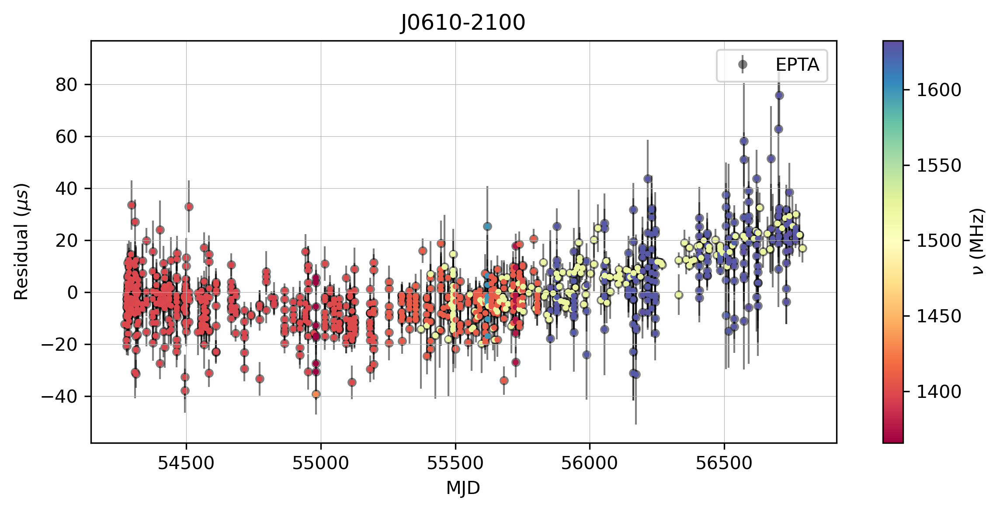

...

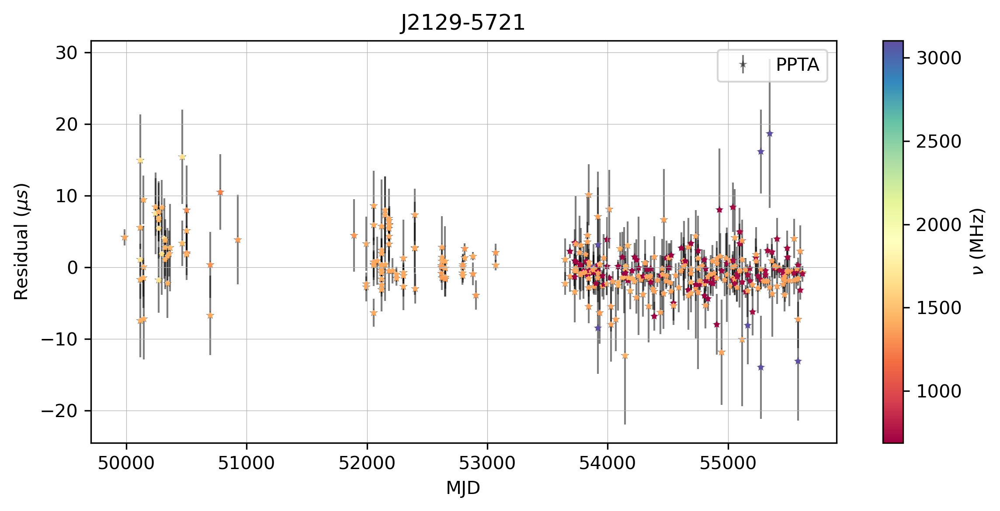

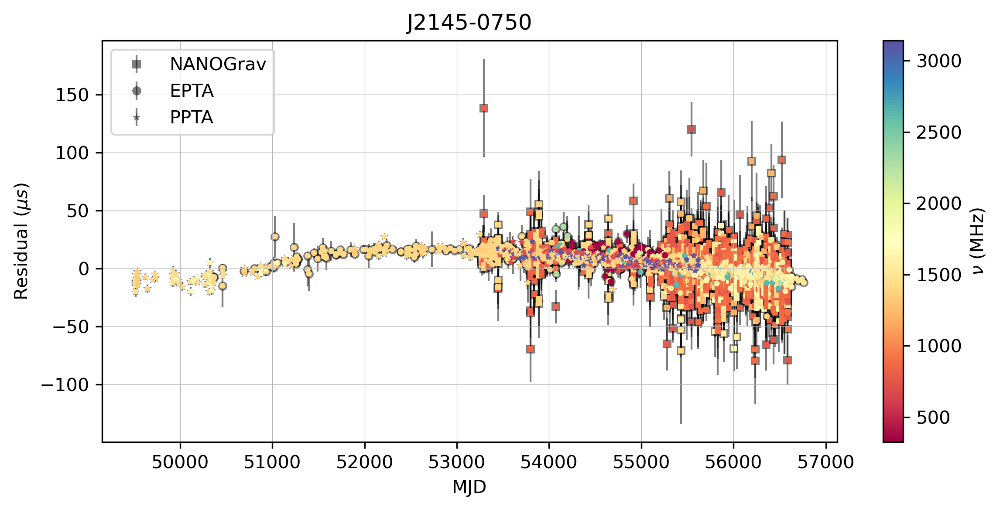

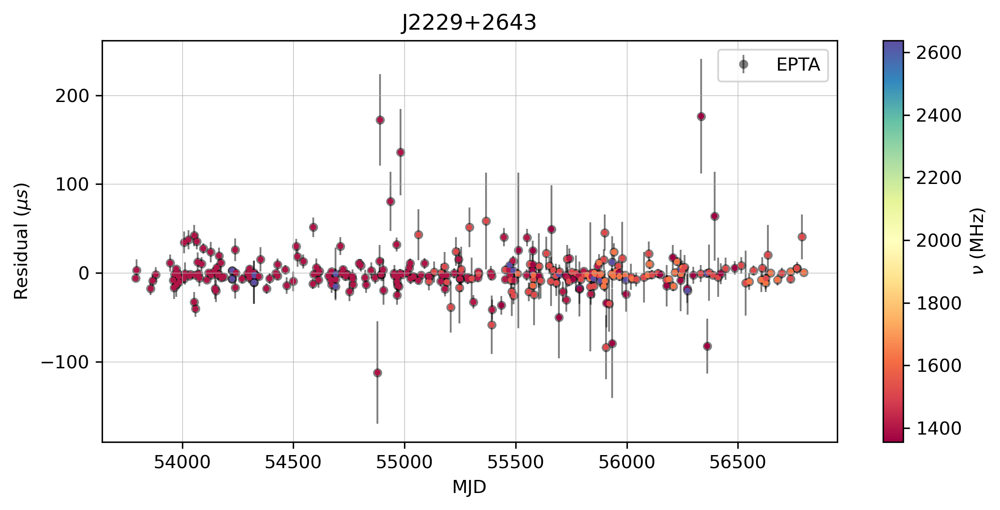

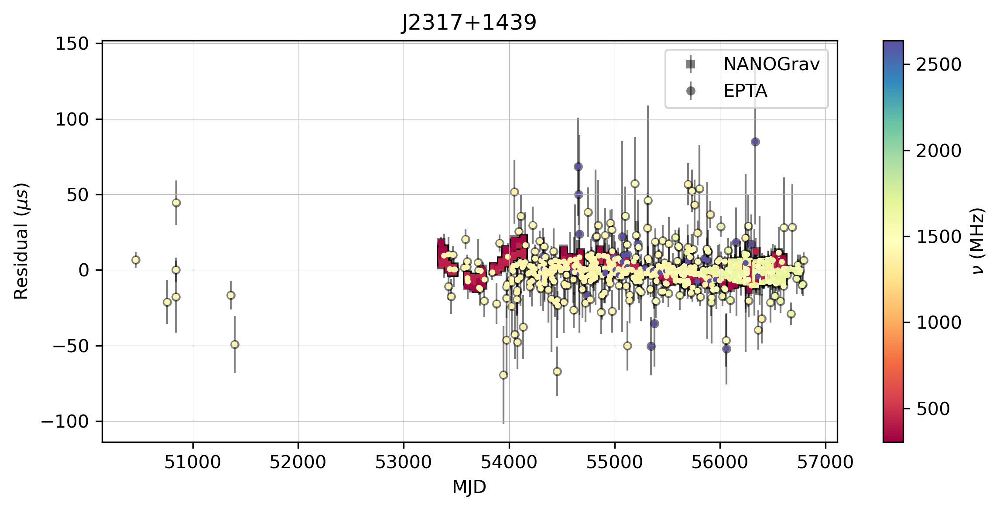

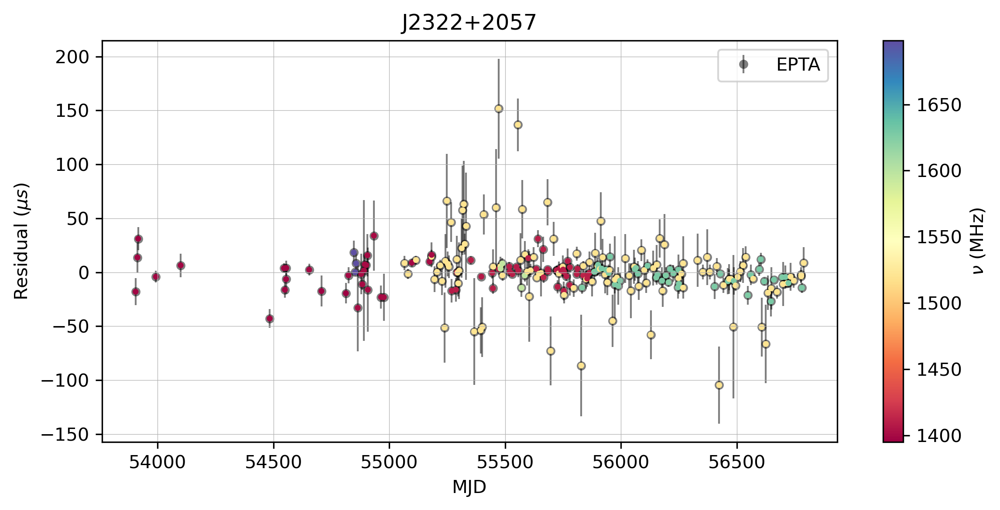

In [18]:
pfiles = glob.glob(f'{savedir}/J*.hdf5')
for file in pfiles:
    psr = FilePulsar(file)
    plot_resids(psr, save=figsave)

/tmp/ipykernel_2762991/3613898205.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(8,4))


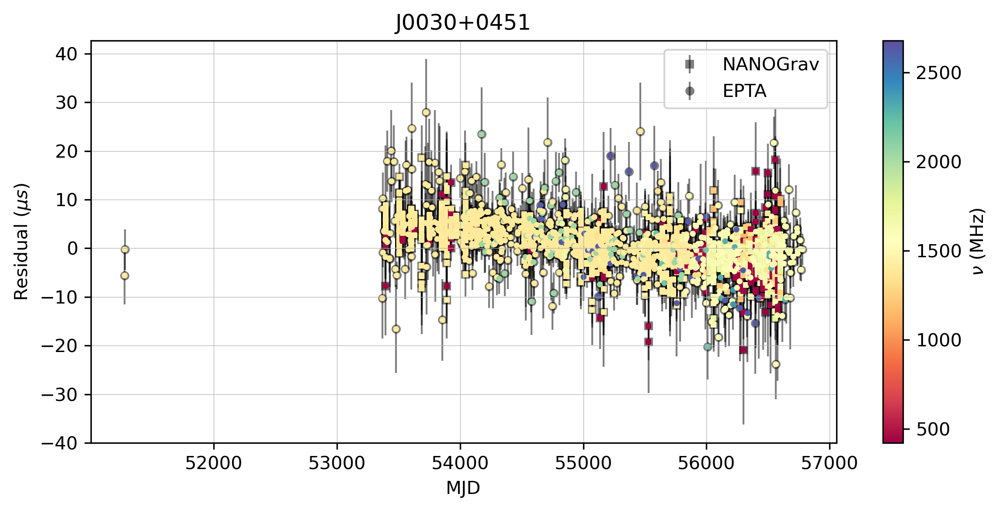

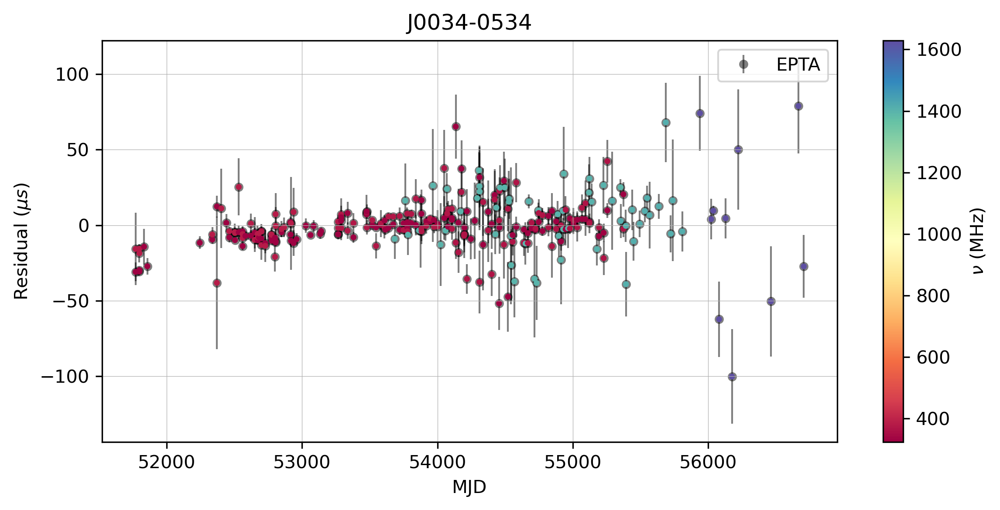

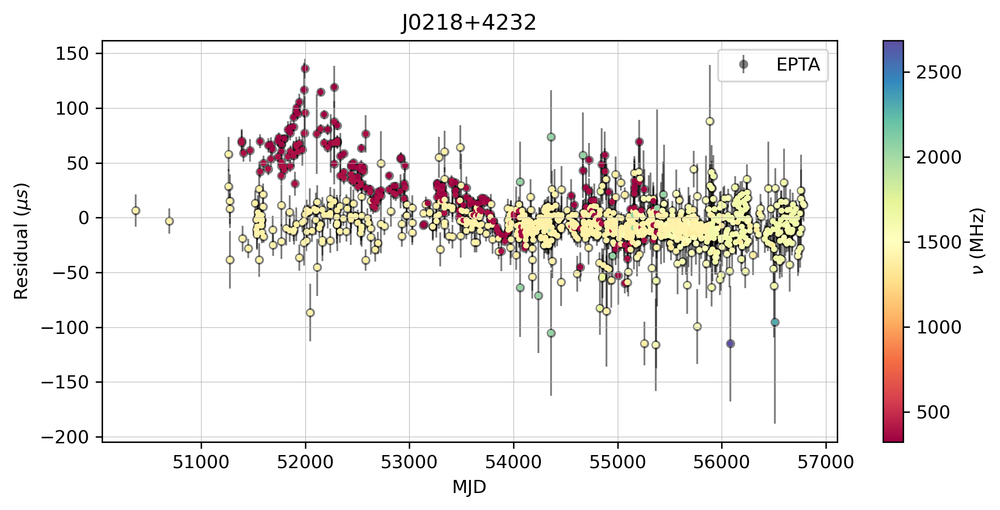

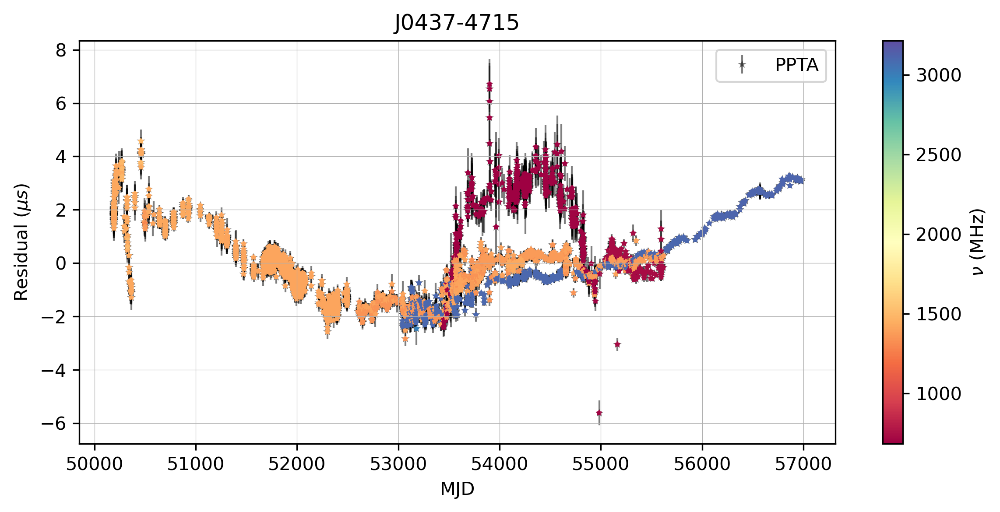

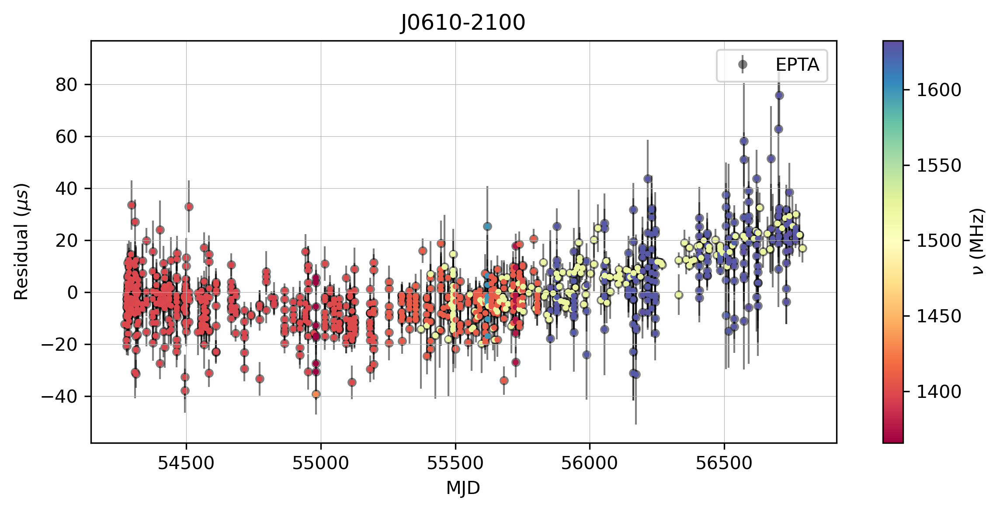

...

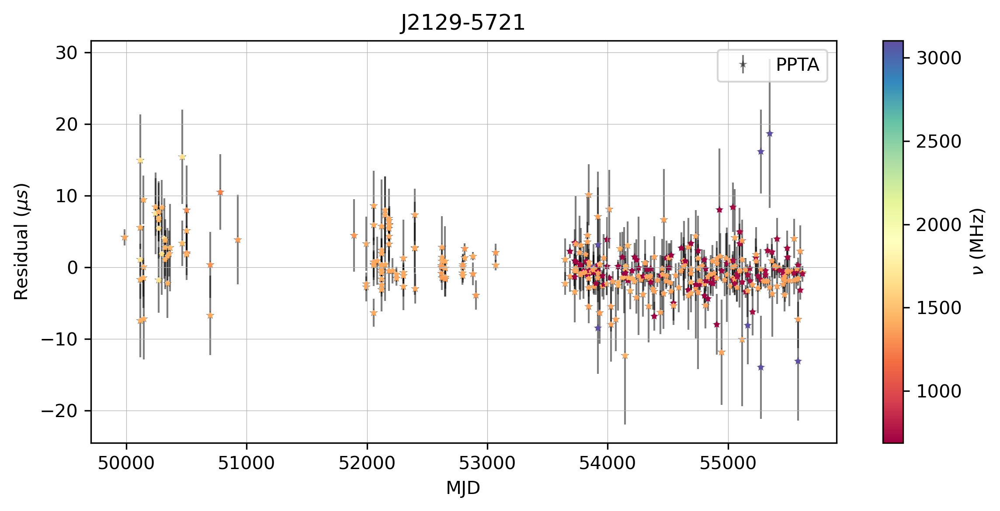

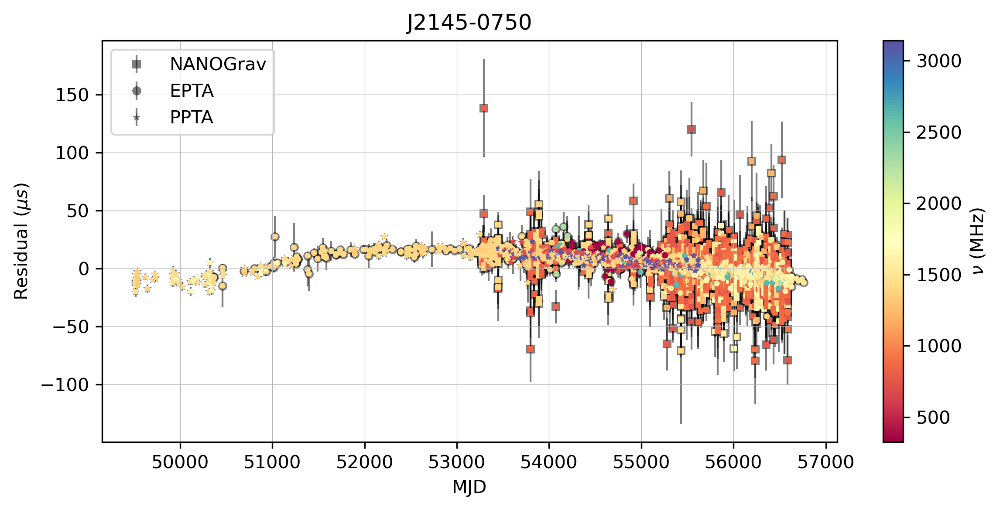

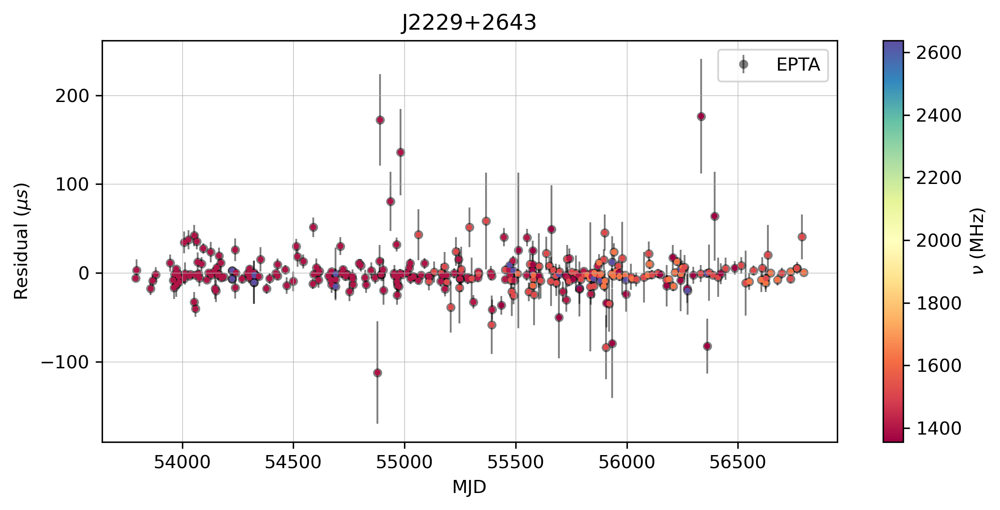

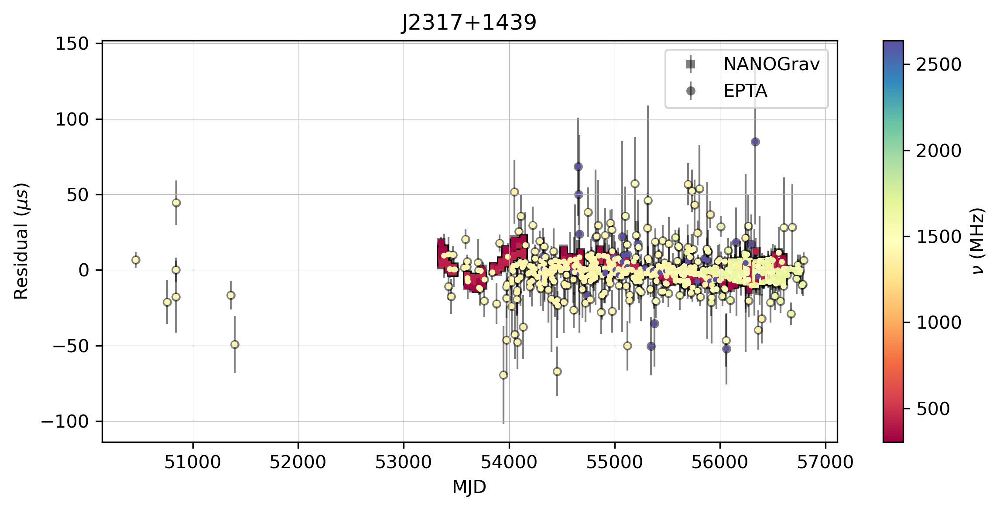

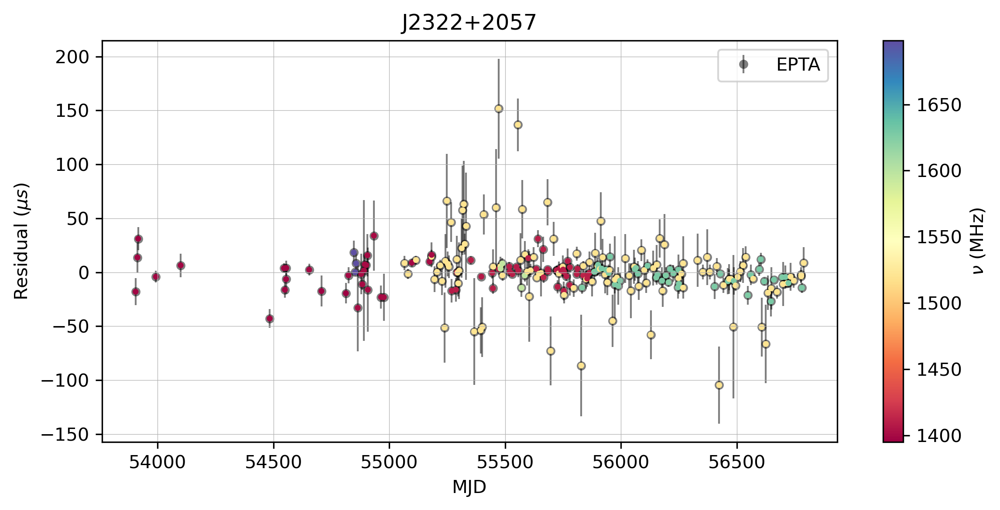

In [28]:
# Here's all the prenoise residual plots
pfiles = glob.glob(f'{savedir}/J*.hdf5')
for psr in psrs:
    plot_resids(psr)